# Thermal perception

This dataset is intended to be used to analyse the conceptual relationships between verbal anchors of one scale, or between one or more scales. 

**Methodology**:  several rounds of face-to-face discussions email conversations as well as an online survey; questionaire in english,  Mandarin (with simplifed Chinese), German, Korean and Swedish translations were subsequently prepared by native language experts familiar with the concepts used in the questionnaire; . In case researchers used other languages than the above mentioned, they had to translate the questionnaire into their language following the same procedure as initially applied – including piloting the new language version with at least 7 individuals beforehand\
**Procedure**: First, the questionnaire was applied without further explanation to at least 7 individuals, of which 2 had to be experienced in the field of human thermal comfort, after collecting the questionnaires, researchers discussed with the participants the length of the questionnaire, the clarity of instructions, and issues when flling out the questionnaire. The observations made through these applications were discussed among the core group and refected in the revised and fnal versions of the questionnaire.

Many perference scale such as ISO 10551 tends to be misinterpreted by respondents as also pointed out earlier

![Places of application of questionnaires (red dots) and places of origin of the 8225 participants (blue diamonds) in this study](./img1.jpg)

Places of application of questionnaires (red dots) and places of origin of the 8225 participants (blue diamonds) in this study

**Relevant work**

Schweiker, Marcel & Abdul-Zahra, Amar & André, Maíra & Atrash, Farah & Al-Khatri, Hanan & Alprianti, Rea & Alsaad, Hayder & Amin, Rucha & Ampatzi, Eleni & Arsano, Alpha Yacob & Montazami, Azadeh & Azar, Elie & Bannazadeh, Bahareh & Batagarawa, Amina & Becker, Susanne & Buonocore, Carolina & Cao, Bin & Choi, Joon-Ho & Chun, Chungyoon & Zomorodian, Mahsa. (2020). Publisher Correction: The Scales Project, a cross-national dataset on the interpretation of thermal perception scales. Scientific Data. 7. 10.1038/s41597-019-0348-3.


## EDA


First we should understand what the columns are representing.

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt 
import datetime
import math
%matplotlib inline

In [2]:
### Import the data
df = pd.read_excel('Dataset.xlsx')

In [3]:
### Print the first 5 rows
print(df.shape)
df.head(5)

(8225, 137)


,Index,SurvID,Q1_Pos2,Q1_Pos3,Q1_Pos4,Q1_Pos5,Q1_Pos6,Q1Equi,Q1ComfLow,Q1ComfHigh,...,lonSurv,latSurv,unID,Q1ComfLowUnadj,Q1ComfHighUnadj,Q2AccLowUnadj,Q2AccHighUnadj,SensType,StatusHVACcat,CommentsCat
0,1,AEKUS01,10.0,19.0,46.0,69.0,90.0,2.0,16.0,22.0,...,NaN,NaN,AEKUS011,16.0,22.0,65.0,72.0,3h,Air conditioned,Not clear (beginning)
1,2,AEKUS01,8.0,20.0,70.0,85.0,94.0,3.0,54.0,63.0,...,NaN,NaN,AEKUS012,54.0,63.0,17.0,27.0,3h,Air conditioned,NaN
2,3,AEKUS01,16.0,32.0,52.0,70.0,89.0,1.0,NaN,NaN,...,NaN,NaN,AEKUS013,NaN,NaN,80.0,92.0,3h,Air conditioned,NaN
3,4,AEKUS01,16.0,25.0,60.0,71.0,80.0,2.0,5.0,10.0,...,NaN,NaN,AEKUS014,5.0,10.0,80.0,86.0,3h,Air conditioned,NaN
4,5,AEKUS01,24.0,44.0,54.0,63.0,80.0,2.0,43.0,46.0,...,NaN,NaN,AEKUS015,43.0,46.0,28.0,30.0,2,Air conditioned,NaN


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8225 entries, 0 to 8224
Columns: 137 entries, Index to CommentsCat
dtypes: datetime64[ns](2), float64(102), int64(4), object(29)
memory usage: 8.6+ MB


In [5]:
df.describe()

,Index,Q1_Pos2,Q1_Pos3,Q1_Pos4,Q1_Pos5,Q1_Pos6,Q1Equi,Q1ComfLow,Q1ComfHigh,Q2_Pos2,...,TinOpSurv,RHinSurv,AvinSurv,Tin,lonSurv,latSurv,Q1ComfLowUnadj,Q1ComfHighUnadj,Q2AccLowUnadj,Q2AccHighUnadj
count,8225.000000,7829.000000,7875.000000,7876.000000,7862.000000,7668.000000,8095.000000,7136.000000,7075.000000,7865.000000,...,846.000000,4371.000000,2101.000000,5031.000000,0.0,0.0,7136.000000,7076.000000,7088.000000,7034.000000
mean,27.484255,15.929833,30.228270,47.098396,63.951076,80.065477,1.992464,38.039439,53.793975,33.015489,...,24.294553,49.197718,0.157473,23.870573,NaN,NaN,37.851668,53.410331,15.846402,34.202061
std,26.063713,8.790935,9.364992,8.415637,10.200522,10.636624,0.821365,17.337305,17.920436,17.826479,...,4.049957,13.899211,0.164178,2.900617,NaN,NaN,17.341086,18.007036,20.420767,22.317058
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,-13.000000,-8.000000,0.000000,...,13.180000,18.000000,0.000000,17.400000,NaN,NaN,-13.000000,-8.000000,-20.000000,-9.000000
25%,9.000000,10.204082,24.000000,44.000000,58.000000,75.000000,2.000000,26.000000,42.000000,20.000000,...,22.800000,38.300000,0.040000,21.900000,NaN,NaN,26.000000,42.000000,0.000000,17.000000
50%,20.000000,15.000000,30.000000,48.000000,64.000000,82.000000,2.000000,38.480851,54.000000,28.000000,...,25.030000,48.600000,0.100000,23.650000,NaN,NaN,38.000000,53.000000,9.000000,30.000000
75%,37.000000,20.000000,36.000000,51.000000,70.000000,86.536158,2.000000,48.000000,66.000000,46.000000,...,26.690000,60.000000,0.200000,25.625000,NaN,NaN,48.000000,66.000000,26.000000,50.000000
max,161.000000,96.000000,100.000000,100.000000,100.000000,101.063830,45.000000,100.000000,110.000000,98.000000,...,33.900000,82.400000,0.700000,33.933333,NaN,NaN,100.000000,192.000000,96.000000,110.000000


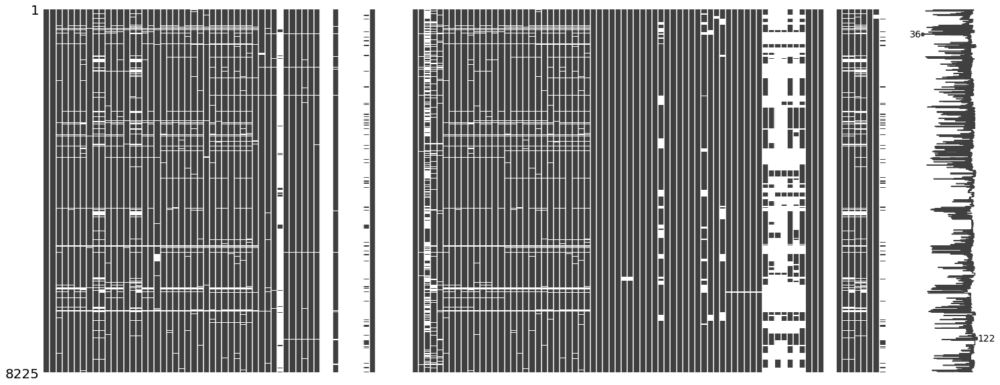

In [6]:
# Missing data
import missingno as msno
msno.matrix(df)
# some columns are missing entirely 

Missingno is a package to visualize the missing values in the dataset. The sparkline at the right describes the completeness of the rows. We can see some columns completely empty, while some columns suffer a large amount of data missing. Now the question is: *What are those columns?*  

In [1051]:
# All empty columns
df.columns[df.isna().all()].tolist()

['CityRes',
 'CountryRes',
 'CityBefRes',
 'CountryBefRes',
 'CityOrigin',
 'CountryOrigin',
 'CountryResFct',
 'CountryResCode',
 'CountryBefResFct',
 'CountryBefResCode',
 'CountryOriginFct',
 'CountryOriginCode',
 'lonSurv',
 'latSurv']

In [20]:
# First 20 largest amount of missing values columns in descending order
pd.DataFrame((df.isnull().sum()/8225*100).sort_values(ascending=False),columns=['Percentage of missing value (%)'])[len(empty_cols):len(empty_cols)+20]

,Percentage of missing value (%)
PlaceOther,94.370821
TinOpSurv,89.714286
CommentsCat,89.629179
TinRadSurv,88.924012
Comment,87.112462
TinGlobeSurv,76.741641
AvinSurv,74.455927
ClimBefRes,51.088146
RHinSurv,46.857143
TinAirSurv,39.659574


In [10]:
# Duplicated data
df[df.duplicated()]
# All rows are unique 

,Index,SurvID,Q1_Pos2,Q1_Pos3,Q1_Pos4,Q1_Pos5,Q1_Pos6,Q1Equi,Q1ComfLow,Q1ComfHigh,...,lonSurv,latSurv,unID,Q1ComfLowUnadj,Q1ComfHighUnadj,Q2AccLowUnadj,Q2AccHighUnadj,SensType,StatusHVACcat,CommentsCat


### A summary of the data quality 

Here we provide a summary of the data quality

In [8]:
# read a new edited book
description = pd.read_excel("Codebook_ScalesStudy_modified.xlsx")

In [35]:
# Quick read 
def check_description(col,item='Details'):
    return description[description['Variable name'] == col][item].values[0]

# Example
print("Detail for column 'Q1ComfLow': ",check_description('Q1ComfLow'))

Detail for column 'Q1ComfLow':  Distance in mm from left side (position of “cold”), i.e. cold is having the value “0” and hot the value of “100”


In [16]:
# Data type of the columns 
description[description.type.notnull()].type.value_counts()

continuous    76
nominal       33
discrete       6
time           5
interval       2
Others         1
Name: type, dtype: int64

After examining the unique values in each column, we identify their data type and potential problem. We add these note in the provided dictionary book.  

We categorise columns into 6 general data types: nominal, continuous, discrete, time, interval and others. 76 columns are continuous data, following by nominal, which can be either numerical or literal. We feel it would be good to define some of the unique types such as time, interval into its own category. The one column in 'Others' is “Comment”, a comment on the survey by participants.  


* **Completeness** \
general description of the missing data is illustrated with missingno package. Some columns do not contain any information, 
Some columns have a large amount of missing data, but in general, most of the columns are mostly completed. 
* **Uniqueness** \
no duplicated found in the dataset
* **Consistency** \
We have found some column is having some filling problem. For example, Some value in column *RespRate* has inconsistent value expression (e.g. 100 and 100% and 0.7). Q1ComfLowUnadj has negative value\ 

 



We found the dataset have lost all of the information in related to the participant previous location of residence, except to the climate. Such lost were also appeared in the same type of information in related to the participant location of residence during survey, which can be traced backed by the other columns. In other words, we only know climate that the participant was coming from or orginated.    

In [18]:
# Here are all the columns that are screened with problem
description[description['problem'] != False]

,Column,Variable name,Description,Source,Details,type,problem
7,8,Q1Equi,1 = All equal; 2 = Some equal; 3 = None equal,Question 1b,NaN,nominal,wrong value
13,14,Q2Equi,1 = All equal; 2 = Some equal; 3 = None equal,Question 2b,NaN,nominal,wrong value
14,15,Q2AccLow,Left end of “acceptable” circle,Question 2c,Distance in mm from left side (position of “co...,continuous,negative value
18,19,Q3Equi,1 = All equal; 2 = Some equal; 3 = None equal,Question 3b,NaN,nominal,wrong value
26,27,Q4bEqui,1 = All equal; 2 = Some equal; 3 = None equal,Question 4b,NaN,nominal,wrong value
34,35,Q4dEqui,1 = All equal; 2 = Some equal; 3 = None equal,Question 4d,NaN,nominal,wrong value
98,99,RespRate,Response rate,Defined by researcher,NaN,continuous,inconsist
130,131,Q1ComfLowUnadj,Unadj of application,NaN,"Same as variable without ending ""Unadj"", but o...",continuous,negative value


Here we pre-process some of the data before getting deeper into each column

In [19]:
# correct wrong value
corr_func = lambda x: x if x in range(1,4) else 3
df['Q1Equi'] = df['Q1Equi'].apply(corr_func)
df['Q2Equi'] = df['Q2Equi'].apply(corr_func)
df['Q3Equi'] = df['Q3Equi'].apply(corr_func)
df['Q4bEqui'] = df['Q4bEqui'].apply(corr_func)
df['Q4dEqui'] = df['Q4dEqui'].apply(corr_func)

In [20]:
# correct wrong range value
def corr_func_2(x):
    if isinstance(x,str):
        return x
    if (0<x<1):
        return int(x*100)
    else: 
        return int(x)

df['RespRate'] = df['RespRate'].apply(corr_func_2)
df.loc[(df['RespRate'] == '100,00%'),'RespRate']= 100

# Univariable analysis

Here we have a look at some important columns. As we are likely to encounter the encoded values, we can make a dictionary so that we can decoded the value temporaily and later decided whether to change the value in the feature engineering phase.\
As I have pointed out in *data_summary*, the columns can be categorized into 3 classes: **scale**, **personal detal**, **sensations during the survey**

In [22]:
FIGSIZE_L = (18,10)
FIGSIZE_S = (10,5)

In [23]:
dics = {}

### Personal detail
Now we look at personal detail. Most of the personal detail are in the form of nominal or discrete values

In [24]:
# Add dictionary for future feature engineering 
dics['Sex'] = {1:'Female',2:'Male',3:'Other',4:'Do not specify'}

Text(0, 0.5, 'percentage')

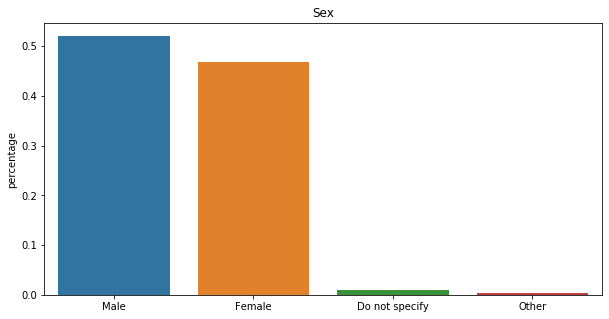

In [25]:
col = 'Sex'
vc = df[col].value_counts(normalize=True)
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title(col)
plt.ylabel('percentage')

In [26]:
dics['Age'] = {1:'< 21', 2:'21-25',3:'26-30',4:'31-35',5:'36-40',6:'> 40',7:'Do not wish to specify'}

Text(0, 0.5, 'percentage')

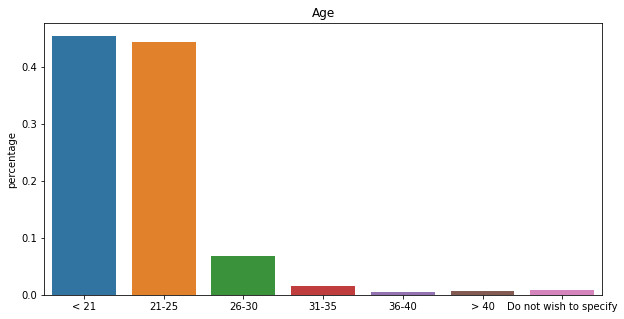

In [27]:
col = 'Age'
vc = df[col].value_counts(normalize=True)
vc = pd.DataFrame(vc).sort_index()[col]
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title(col)
plt.ylabel('percentage')

In [28]:
dics['Adapt'] = {1:'low',2:'middle',3:'high'}

Text(0, 0.5, 'percentage')

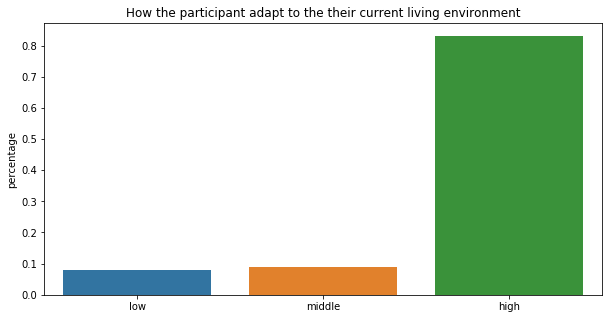

In [29]:
col = 'Adapt'
vc = df[col].value_counts(normalize=True)
vc = pd.DataFrame(vc).sort_index()[col]
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title('How the participant adapt to the their current living environment')
plt.ylabel('percentage')
# 80% of the participants seem to adapt the the environment 

In [30]:
dics['PeriodRes'] = {1:'< 1 year',2:'1-3 years',3:'> 3 years',4:'Do not specify'}

Text(0, 0.5, 'percentage')

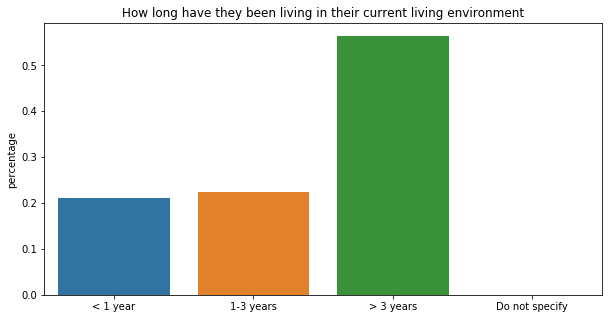

In [31]:
col = 'PeriodRes'
vc = df[col].value_counts(normalize=True)
vc = pd.DataFrame(vc).sort_index()[col]
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title('How long have they been living in their current living environment')
plt.ylabel('percentage')
# We can see there are 40% of people who live no more than three years, as this survey are intended to distribute 
# at the university

### Lauguage

In [32]:
dics['Native'] = {1:'Yes',0:'No'}

Text(0, 0.5, 'percentage')

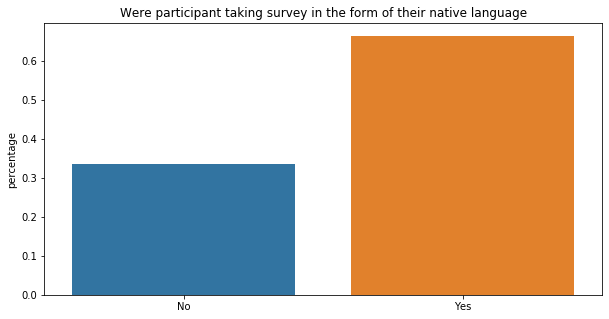

In [33]:
col = 'Native'
vc = df[col].value_counts(normalize=True)
vc = pd.DataFrame(vc).sort_index()[col]
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title('Were participant taking survey in the form of their native language')
plt.ylabel('percentage')

Text(0.5, 1.0, 'Survey Language available')

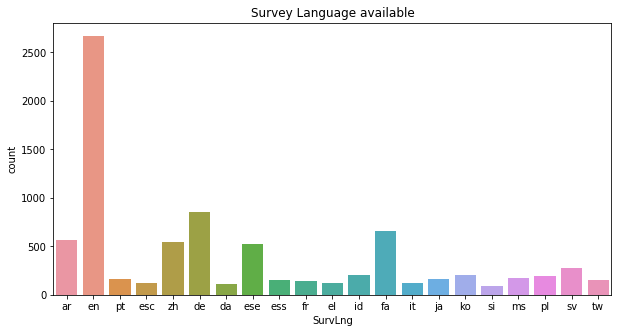

In [34]:
plt.figure(figsize=FIGSIZE_S)
sns.countplot(x='SurvLng',data=df)
plt.title('Survey Language available')
# There are significant amount of survey conducted in english, following by German(de), Persian(fa), Arabic(ar), Chinese(zh)
# and spanish (ese)

In [36]:
# What the observer see during the survey 
df['SurvObs'].value_counts()

nothing special                                                1303
none                                                            293
Blinds closed for lecture                                       243
SurvObs                                                         187
no nosie                                                        167
                                                               ... 
no blinds electric light switch off, windows closed              11
11 unfinished questionnaires                                     10
NOISE FROM FAN OF THE COMPUTER SERVER, STUDENTS TALK QUIETY      10
Small classroom with few students fluorescent light               9
Crowded warm and humid quiet                                      4
Name: SurvObs, Length: 101, dtype: int64

### Season

In [37]:
dics['Season'] = {
    'Summer':'Summer', 'Fall':'Autumn', 'summer':'Summer', 'Winter ':'Winter', 'winter':'Winter', 'Autumn ':'Autumn',
    'Winter':'Winter', 'Spring':'Spring', 'spring':'Spring', 'autumn':'Autumn', 'Autumn':'Autumn', 'Wet':'Wet', 'Wet ':'Wet',
    'Dry':'Dry', 'Automn':'Autumn','wet':'Wet', 'Monsoon':'Summer', 'summer dry':'Summer',
    'winter dry':'Winter', 'summer not dry or wet':'Summer',
    'Second Inter-Monsoon Season':'Autumn', 'Southwest-monsoon Season':'Summer',
    'Hot':'Summer','Wet Season':'Wet', 'dry':'Dry', 'DRY':'Dry', 'fall':'Autumn'}

Winter                         1606
Summer                         1241
Wet                             812
Autumn                          758
Spring                          678
winter                          598
summer                          482
Dry                             356
Fall                            353
autumn                          164
wet                             142
spring                          116
fall                             95
summer dry                       88
Wet                              85
Wet Season                       78
Monsoon                          74
Autumn                           69
winter dry                       65
Winter                           59
Second Inter-Monsoon Season      54
Southwest-monsoon Season         50
DRY                              50
Automn                           46
Hot                              45
summer not dry or wet            36
dry                              25
Name: Season, dtype: int64


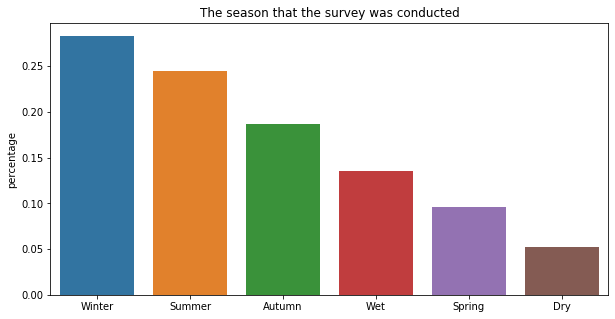

In [38]:
print(df['Season'].value_counts())
col = 'Season'
# df[f'{col}_m1'] = df[col].apply(lambda x: dics[col][x])
vc = df[col].apply(lambda x: dics[col][x]).value_counts(normalize=True)
x = vc.index
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title('The season that the survey was conducted')
plt.ylabel('percentage')
plt.show()

# Create a new columns for later use

Here we give the season that the survey was conducted. Part of the classes are repeated or misspelling, but there are a considerable amount of participants provide the answers that are not in the traditional four seasons. Based on the terms used, we group all classes into 6 categories: Winter, Summer, Autumn, Spring, Wet and Dry.\
Most of the survey is conducted in Winter, following but Summer, where they accumulated over 50 percent of the entire of the survey.

In [39]:
dics['Month'] = {1:'Jan',2:"Feb",3:"Mar",4:"Apr",5:"May",6:"Jun",7:"Jul",8:"Aug",9:"Sept",10:"Oct",11:"Nov",12:"Dec"}

Text(0.5, 1.0, 'The month that the survey was conducted')

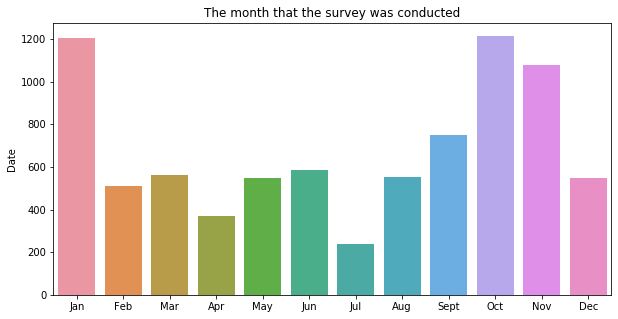

In [40]:
vc = df['Date'].apply(lambda x: x.month).value_counts().sort_index().rename(dics['Month'])

plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=vc.index,y=vc)
plt.title('The month that the survey was conducted')

Look at the month that the survey was conducted, we can see October, November and January had significantly higher participation among the year. While in December, despite between November and January, the participation is as low as the average. On the other hand, April, July had significantly lower participation among the year. It is likely because most of the participants are in college. That also explains hemisphere did not take place, where the academic terms time are regular regardless of countries and hemisphere.

In [41]:
# Add a new columns 
df['Month'] = df['Date'].apply(lambda x: x.month)

In [42]:
# Season
df[df['Season'] == 'Spring']['Month'].value_counts()

5.0    236
4.0    212
3.0    177
9.0     52
Name: Month, dtype: int64

In [43]:
# Hot
df[df['Season'] == 'Hot'].head()

,Index,SurvID,Q1_Pos2,Q1_Pos3,Q1_Pos4,Q1_Pos5,Q1_Pos6,Q1Equi,Q1ComfLow,Q1ComfHigh,...,latSurv,unID,Q1ComfLowUnadj,Q1ComfHighUnadj,Q2AccLowUnadj,Q2AccHighUnadj,SensType,StatusHVACcat,CommentsCat,Month
3802,1,HKCHU03,24.870466,34.715026,48.704663,60.621762,73.575130,3.0,9.844560,39.896373,...,NaN,HKCHU031,9.5,38.5,0.0,61.5,2,Air conditioned,NaN,9.0
3803,2,HKCHU03,29.015544,36.269430,55.440415,62.694301,68.911917,2.0,56.994819,59.585492,...,NaN,HKCHU032,55.0,57.5,25.5,30.0,2,Air conditioned,NaN,9.0
3804,3,HKCHU03,14.507772,32.124352,48.704663,65.284974,82.383420,1.0,NaN,NaN,...,NaN,HKCHU033,NaN,NaN,NaN,NaN,2,Air conditioned,NaN,9.0
3805,4,HKCHU03,NaN,33.160622,NaN,NaN,51.813472,3.0,NaN,NaN,...,NaN,HKCHU034,NaN,NaN,NaN,NaN,2,Air conditioned,NaN,9.0
3806,5,HKCHU03,40.414508,53.886010,57.512953,67.357513,76.165803,2.0,NaN,NaN,...,NaN,HKCHU035,NaN,NaN,NaN,NaN,2,Air conditioned,NaN,9.0


In [44]:
print(df[df['Season'] == 'Hot'].SurvID.value_counts())

HKCHU03    45
Name: SurvID, dtype: int64


We also need to aware of the location, for example, participants in south hemisphere may fill season Spring in September. Therefore we do not split Wet and Dry based on the month where the season is traditionally corresponding to. On the other hand, how people fill with this information is also interesting to study. For example, we found that the participants filling season Hot were likely to come from Hong Kong, based on the SurvID code. Hence, further analysis is needed.

### Climate

![code](./kg_map.png)

Climate is a bit tricky because it is determined by Köppen Climate Classification. Typical climate code consists of two to three characters depended on the climate. The 1st character is the main climate code of the region, typically it is based on the the location to the equator/polar with some exception (such as Tibet (ET)). The 2nd character is the precipitation code of the region. The 3rd character is the temperature code of the region. However, there are some exception for the places that the main climate are classified as equatorial(A) or polar(E), where equatorial(A) code is following by only the precipitation code and polar(E) does not have the precipitation code. \
It is worth to noticed that there are new version to forcast the climate for the next 100 years. The one above is 2006 version updated by Kottek, M .al and the survey use this version to classify the climate of the location. 

Here we use 0 to 1 to encode the the information, the rule is by highest(1) temperature/precipitation to the lowest(0) temperature/precipitation. For equatorial(A) region, we assume the temperatue code is *hot arid*, while for polar(E) region, we assume the precipitation is *desert*.

In [45]:
kg_climate_dic = {0:{'A':1.0,'B':0.75,"C":0.5,"D":0.25,"E":0.0},
                  1:{"f":1.0,"m":0.8,"s":0.6,"w":0.4,"S":0.2,"W":0.0},
                  2:{'h':1.0,'k':0.86,'a':0.71,'b':0.57,'c':0.42,'d':0.28,'T':0.14,'F':0.0}}

def kg_to_numeric(string,dic=kg_climate_dic):
    if string[0] == 'A':
        num_1 = dic[0][string[0]]
        num_2 = dic[1][string[1]]
        num_3 = 1
    elif string[0] == 'E':
        num_1 = dic[0][string[0]]
        num_2 = 0
        num_3 = dic[2][string[1]]
    else:
        num_1 = dic[0][string[0]]
        num_2 = dic[1][string[1]]
        num_3 = dic[2][string[2]]
    return [num_1,num_2,num_3]

In [46]:
for col in ['ClimRes','ClimBefRes','ClimOrigin']:
    df[f'{col}_num'] = 0
    df[f'{col}_num'] = df[df[col].notnull()][col].apply(lambda x:kg_to_numeric(x))
    df[f'{col}_dim1'] = df[df[col].notnull()][f'{col}_num'].apply(lambda x:x[0])
    df[f'{col}_dim2'] = df[df[col].notnull()][f'{col}_num'].apply(lambda x:x[1])
    df[f'{col}_dim3'] = df[df[col].notnull()][f'{col}_num'].apply(lambda x:x[2])
    df=df.drop(labels=f'{col}_num',axis=1)


In [47]:
df.head()

,Index,SurvID,Q1_Pos2,Q1_Pos3,Q1_Pos4,Q1_Pos5,Q1_Pos6,Q1Equi,Q1ComfLow,Q1ComfHigh,...,Month,ClimRes_dim1,ClimRes_dim2,ClimRes_dim3,ClimBefRes_dim1,ClimBefRes_dim2,ClimBefRes_dim3,ClimOrigin_dim1,ClimOrigin_dim2,ClimOrigin_dim3
0,1,AEKUS01,10.0,19.0,46.0,69.0,90.0,2.0,16.0,22.0,...,6.0,0.75,0.0,1.0,0.75,0.0,1.00,0.75,0.0,1.00
1,2,AEKUS01,8.0,20.0,70.0,85.0,94.0,3.0,54.0,63.0,...,6.0,0.75,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN
2,3,AEKUS01,16.0,32.0,52.0,70.0,89.0,1.0,NaN,NaN,...,6.0,0.75,0.0,1.0,0.75,0.0,1.00,0.75,0.2,0.86
3,4,AEKUS01,16.0,25.0,60.0,71.0,80.0,2.0,5.0,10.0,...,6.0,0.75,0.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN
4,5,AEKUS01,24.0,44.0,54.0,63.0,80.0,2.0,43.0,46.0,...,6.0,0.75,0.0,1.0,0.50,1.0,0.57,0.50,1.0,0.57


In [50]:
dim1_dic = {0:"polar",.25:"snow",.5:"warm",.75:"arid",1:"quaatorial"}
dim2_dic = {0.0:'desert',0.2:'steppe',1.0:'fully humid',0.6:'summer dry',0.4:'winter dry',0.8:'monsoonal'}
dim3_dic = {1.0:'hot arid',0.71:'hot summer',0.57:'warm summer',0.42:'cool summer',
                            0.28:'extremely continental',0.14:'polar tundra',0.0:'polar frost',0.86:'cold arid'}

for col in ['ClimRes','ClimBefRes','ClimOrigin']:
    for i in range(1,4):
        dics[f'{col}_dim1'] = dim1_dic
        dics[f'{col}_dim2'] = dim2_dic
        dics[f'{col}_dim3'] = dim3_dic




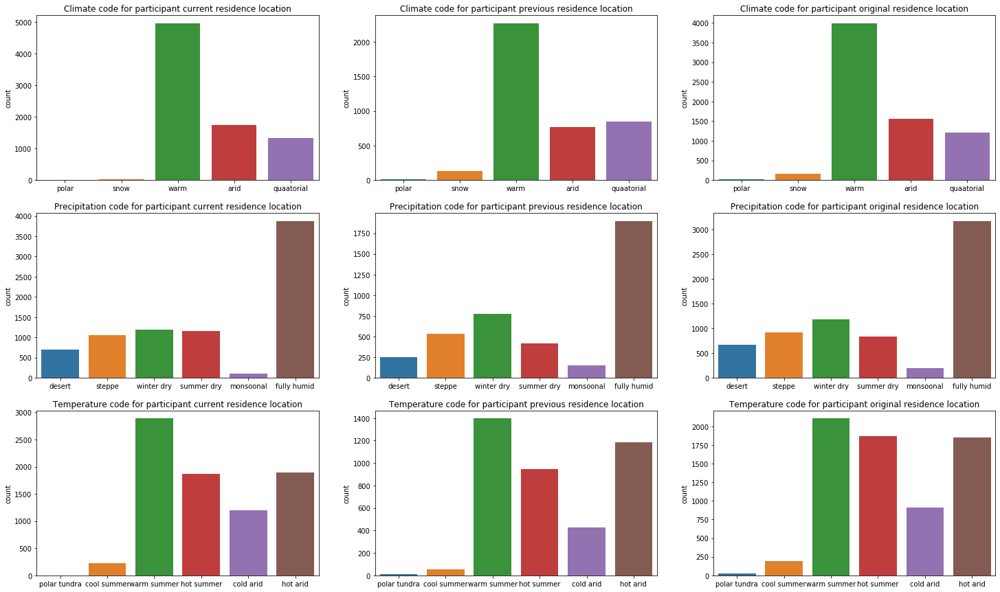

In [51]:
code_name1 = ['Climate code','Precipitation code','Temperature code']
code_name2 = ['participant current residence location','participant previous residence location','participant original residence location']

f,axs = plt.subplots(3,3,figsize=(25,15))
for i,col in enumerate(['ClimRes','ClimBefRes','ClimOrigin']):
    for d in range(0,3):
        vc = df[f'{col}_dim{d+1}'].value_counts().sort_index().rename(dics[f'{col}_dim{d+1}'])
        sns.barplot(x=vc.index,y=vc,ax=axs[d,i])
        axs[d,i].set_title(f'{code_name1[d]} for {code_name2[i]}')
        axs[d,i].set_ylabel('count')

### Scale

In [62]:
# Here we ensure all the scale are within 0 to 100
def corr_func_3(x):
    if x >100:
        return 100
    elif x<0:
        return 0
    else:
        return x
    
scale_cols = ['Q1_Pos2', 'Q1_Pos3', 'Q1_Pos4', 'Q1_Pos5', 'Q1_Pos6', 
              'Q2_Pos2', 'Q2_Pos3', 'Q2_Pos4', 
              'Q3_Pos2', 'Q3_Pos3'] + [f"Q{i}_Pos{j}" for i in [4,5] for j in range(1,8)] + \
              ['Q1ComfLow','Q1ComfHigh','Q2AccLow','Q2AccHigh']

for col in scale_cols:
    df[col] = df[col].apply(corr_func_3)
    
# We normalize the scale columns and Create a new dataframe 
df_scale = df[scale_cols]/100

<Figure size 432x288 with 0 Axes>

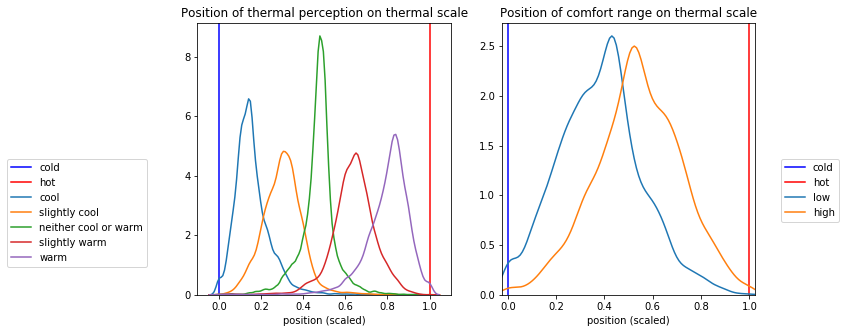

In [63]:
plt.figure()
f,(ax,ax2) = plt.subplots(1,2,figsize=FIGSIZE_S)
plt.xlim(-0.025,1.025)
q1 = [f'Q1_Pos{i}' for i in range(2,7) ]
ax.set_title('Position of thermal perception on thermal scale')
ax.axvline(x=0,c='b')
ax.axvline(x=1,c='r')
for col in q1:
    sns.distplot(a=df_scale[col],kde=True,hist=False,label='',ax=ax)
    
ax.legend(['cold','hot','cool','slightly cool','neither cool or warm','slightly warm','warm'],
           bbox_to_anchor=(-0.75, 0.5), loc=2, borderaxespad=0.)


ax2.set_title('Position of comfort range on thermal scale')
ax2.axvline(x=0,c='b')
ax2.axvline(x=1,c='r')
for col in ['Q1ComfLow','Q1ComfHigh']:
    sns.distplot(a=df_scale[col],kde=True,hist=False,ax=ax2,label='')
ax2.legend(['cold','hot','low','high'],bbox_to_anchor=(1.1, 0.5), loc=2, borderaxespad=0.)


ax.set_xlabel('position (scaled)')
ax2.set_xlabel('position (scaled)')
plt.show()

From the figure, we can see slightly warm/cool and neither cool nor warm are quite symmetrical, whereas we can see more differences in the distributions between cool and warm

<Figure size 432x288 with 0 Axes>

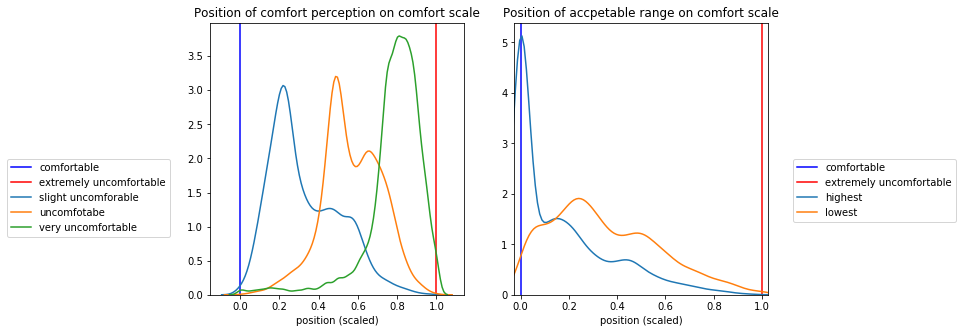

In [64]:
plt.figure()
f,(ax,ax2) = plt.subplots(1,2,figsize=FIGSIZE_S)
plt.xlim(-0.025,1.025)
q1 = [f'Q2_Pos{i}' for i in range(2,5) ]
ax.set_title('Position of comfort perception on comfort scale')
ax.axvline(x=0,c='b')
ax.axvline(x=1,c='r')
for col in q1:
    sns.distplot(a=df_scale[col],kde=True,hist=False,label='',ax=ax)

legend_ = [[
    'comfortable',
    'extremely uncomfortable'],[
    'slight uncomforable',
    'uncomfotabe',
    'very uncomfortable',],[
    'highest','lowest'
]]  
    
ax.legend(legend_[0]+legend_[1],
           bbox_to_anchor=(-0.8, 0.5), loc=2, borderaxespad=0.)

ax2.set_title('Position of accpetable range on comfort scale')
ax2.axvline(x=0,c='b')
ax2.axvline(x=1,c='r')
for col in ['Q2AccLow','Q2AccHigh']:
    sns.distplot(a=df_scale[col],kde=True,hist=False,ax=ax2,label='')
ax2.legend(legend_[0]+legend_[2],bbox_to_anchor=(1.1, 0.5), loc=2, borderaxespad=0.)


ax.set_xlabel('position (scaled)')
ax2.set_xlabel('position (scaled)')
plt.show()

<Figure size 576x360 with 0 Axes>

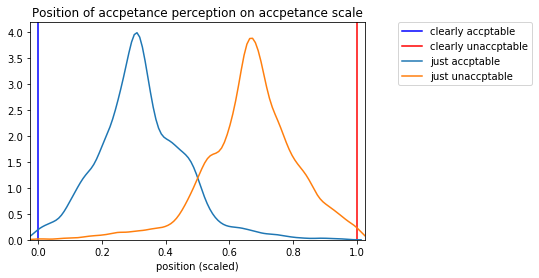

In [65]:
plt.figure(figsize=(8,5))
f,ax = plt.subplots()
plt.xlim(-0.025,1.025)
q1 = [f'Q3_Pos{i}' for i in range(2,4) ]
plt.title('Position of accpetance perception on accpetance scale')
plt.axvline(x=0,c='b')
plt.axvline(x=1,c='r')
for col in q1:
    sns.distplot(a=df_scale[col],kde=True,hist=False,label='',ax=ax)
    
# ax2 = ax.twinx()
# for col in ['Q2AccLow','Q2AccHigh']:
#     sns.distplot(a=df_scale[col],kde=False,hist=True,ax=ax2,label='')
# ax2.legend(['low','high'],
#            bbox_to_anchor=(1.1, 0.15), loc=2, borderaxespad=0.)

legend_ = [
    'clearly accptable',
    'clearly unaccptable',
    'just accptable',
    'just unaccptable',
]
ax.legend(legend_,
           bbox_to_anchor=(1.1, 1), loc=2, borderaxespad=0.)
plt.xlabel('position (scaled)')
plt.show()

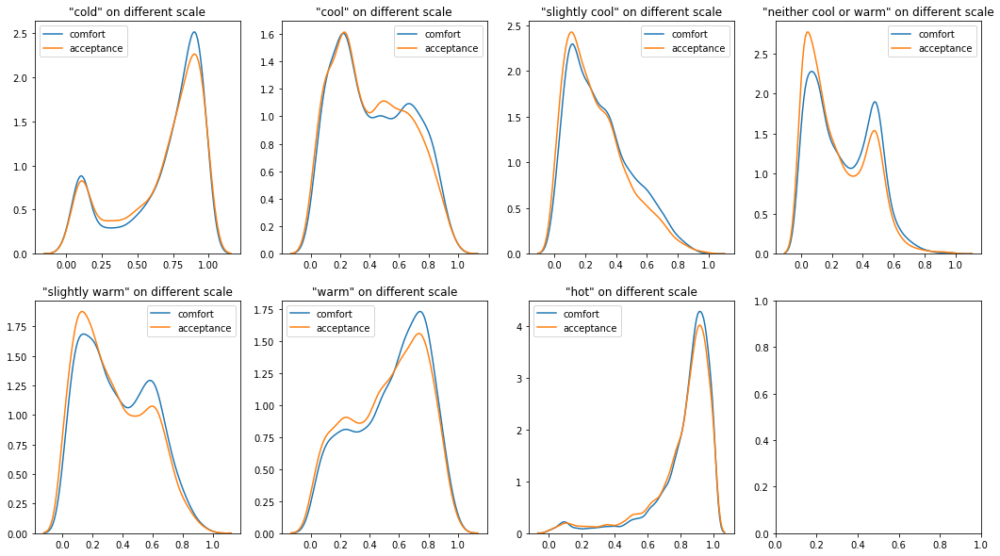

In [66]:
f,axs = plt.subplots(2,4,figsize=(18,10))
legend_ = ['cold','cool','slightly cool','neither cool or warm','slightly warm','warm','hot']

for i in range(0,7):
    sns.distplot(a=df_scale[f'Q4_Pos{i+1}'],kde=True,hist=False,label='comfort',ax=axs[i//4,i%4])
    sns.distplot(a=df_scale[f'Q5_Pos{i+1}'],kde=True,hist=False,label='acceptance',ax=axs[i//4,i%4])
    axs[i//4,i%4].set_title(f'"{legend_[i]}" on different scale')
    axs[i//4,i%4].set_xlabel('')

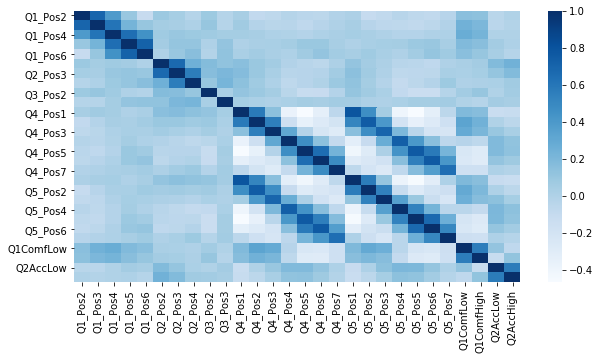

In [67]:
plt.figure(figsize=FIGSIZE_S)
sns.heatmap(df[scale_cols].corr(),cmap='Blues')
plt.show()

When we compare how seven thermal adjectives sit on two different scales: comfort and acceptance. In general, the distributions are quite similar. Now, when we look at the correlation map, we can see there is a noticeable correlation between Q4 (comfort) and Q5 (acceptance) for the same position Pos(thermal adjective). Combine these two pieces of detail. We can say people think *thermal comfort* is associated with *thermal acceptance* when speaking of thermal perception.

In [68]:
df[scale_cols].describe()

,Q1_Pos2,Q1_Pos3,Q1_Pos4,Q1_Pos5,Q1_Pos6,Q2_Pos2,Q2_Pos3,Q2_Pos4,Q3_Pos2,Q3_Pos3,...,Q5_Pos2,Q5_Pos3,Q5_Pos4,Q5_Pos5,Q5_Pos6,Q5_Pos7,Q1ComfLow,Q1ComfHigh,Q2AccLow,Q2AccHigh
count,7829.000000,7875.000000,7876.000000,7862.000000,7668.000000,7865.000000,7854.000000,7812.000000,7851.000000,7816.000000,...,7574.000000,7613.000000,7586.000000,7561.000000,7551.000000,7566.000000,7136.000000,7075.000000,7088.000000,7034.000000
mean,15.929833,30.228270,47.098396,63.951076,80.064922,33.015489,56.766284,78.418384,32.372590,66.745472,...,41.147014,27.150389,23.787922,33.843392,52.115354,80.734597,38.055694,53.792268,16.323608,34.479288
std,8.790935,9.364992,8.415637,10.200522,10.635556,17.826479,15.173301,15.098367,13.687653,14.423782,...,25.059164,19.705609,19.603311,22.843512,25.383073,19.702497,17.298989,17.908907,20.154415,22.418394
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,10.204082,24.000000,44.000000,58.000000,75.000000,20.000000,47.000000,74.000000,24.000000,59.405941,...,20.000000,11.398964,7.000000,14.000000,31.000000,76.000000,26.000000,42.000000,0.000000,17.000000
50%,15.000000,30.000000,48.000000,64.000000,82.000000,28.000000,55.000000,81.000000,31.000000,67.000000,...,38.000000,23.000000,19.000000,30.000000,56.000000,87.000000,38.480851,54.000000,9.000000,30.000000
75%,20.000000,36.000000,51.000000,70.000000,86.536158,46.000000,68.000000,88.000000,40.000000,75.000000,...,62.000000,39.000000,41.424964,52.688172,73.000000,93.000000,48.000000,66.000000,26.157323,50.000000
max,96.000000,100.000000,100.000000,100.000000,100.000000,98.000000,100.000000,100.000000,95.000000,100.000000,...,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,96.000000,100.000000


In [890]:
# Feature engineering on the scales

# We create a new column for identifing  We take position 4, neither cool or warm as the centre
df_scale[f'Q1_Pos_c'] = df_scale['Q1_Pos4']



for i in [2,3,4,5,6]:
    df_scale[f'Q1_Pos{i}'] = df_scale[f'Q1_Pos{i}'] - df_scale[f'Q1_Pos_c']

# # standard deviation    
# df_scale[f'Q1_Pos_std'] = np.sqrt(df_scale['Q1_Pos2']**2+
#                                   df_scale['Q1_Pos3']**2+
#                                   df_scale['Q1_Pos4']**2+
#                                   df_scale['Q1_Pos5']**2+
#                                   df_scale['Q1_Pos6']**2)

df_scale['Q1_Comf_c'] = (df_scale['Q1ComfLow']+df_scale['Q1ComfHigh'])/2
df_scale['Q1_Comf_r'] = (df_scale['Q1ComfHigh']-df_scale['Q1ComfLow'])/2

# Question 2 
df_scale['Q2_Acc_c'] = (df_scale['Q2AccLow']+df_scale['Q2AccHigh'])/2
df_scale['Q2_Acc_r'] = (df_scale['Q2AccHigh']-df_scale['Q2AccLow'])/2

df_scale['Q2_Pos_std'] = np.sqrt(df_scale['Q2_Pos2']**2+
                                  df_scale['Q2_Pos3']**2+
                                  df_scale['Q2_Pos4']**2)

# Question 3 
df_scale[f'Q3_Pos_std'] = np.sqrt(df_scale['Q3_Pos2']**2+
                                  df_scale['Q3_Pos3']**2)


# Question 4-5 
for j in [4,5]:
    df_scale[f'Q{j}_Pos_c'] = df_scale[f'Q{j}_Pos4']

    for i in [1,2,3,4,5,6,7]:
        df_scale[f'Q{j}_Pos{i}'] = df_scale[f'Q{j}_Pos{i}'] - df_scale[f'Q{j}_Pos_c']

#     df_scale[f'Q{j}_Pos_std'] = np.sqrt(df_scale[f'Q{j}_Pos1']**2+
#                                         df_scale[f'Q{j}_Pos2']**2+
#                                         df_scale[f'Q{j}_Pos3']**2+
#                                         df_scale[f'Q{j}_Pos4']**2+
#                                         df_scale[f'Q{j}_Pos5']**2+
#                                         df_scale[f'Q{j}_Pos6']**2+
#                                         df_scale[f'Q{j}_Pos7']**2)

df_scale

,Q1_Pos2,Q1_Pos3,Q1_Pos4,Q1_Pos5,Q1_Pos6,Q2_Pos2,Q2_Pos3,Q2_Pos4,Q3_Pos2,Q3_Pos3,...,Q2AccHigh,Q1_Pos_c,Q1_Comf_c,Q1_Comf_r,Q2_Acc_c,Q2_Acc_r,Q2_Pos_std,Q3_Pos_std,Q4_Pos_c,Q5_Pos_c
0,-0.360000,-0.270000,0.0,0.230000,0.440000,0.690000,0.850000,0.960000,0.100000,0.920000,...,0.720000,0.460000,0.190000,0.030000,0.685000,0.035000,1.456091,0.925419,0.340000,0.350000
1,-0.620000,-0.500000,0.0,0.150000,0.240000,0.440000,0.600000,0.800000,0.320000,0.700000,...,0.270000,0.700000,0.585000,0.045000,0.220000,0.050000,1.092520,0.769675,0.080000,0.060000
2,-0.360000,-0.200000,0.0,0.180000,0.370000,0.500000,0.660000,0.850000,0.440000,0.570000,...,0.920000,0.520000,NaN,NaN,0.860000,0.060000,1.186634,0.720069,0.200000,0.300000
3,-0.440000,-0.350000,0.0,0.110000,0.200000,0.450000,0.560000,0.750000,0.170000,0.750000,...,0.860000,0.600000,0.075000,0.025000,0.830000,0.030000,1.038557,0.769025,0.450000,NaN
4,-0.300000,-0.100000,0.0,0.090000,0.260000,0.290000,0.550000,0.900000,0.430000,0.500000,...,0.300000,0.540000,0.445000,0.015000,0.290000,0.010000,1.093892,0.659469,0.050000,0.080000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8220,-0.319149,-0.138298,0.0,0.138298,0.297872,0.489362,0.712766,0.914894,0.744681,0.819149,...,0.595745,0.478723,0.547872,0.132979,0.297872,0.297872,1.258785,1.107048,0.000000,0.000000
8221,-0.265957,-0.127660,0.0,0.170213,0.265957,0.106383,0.287234,0.521277,0.287234,0.638298,...,NaN,0.500000,NaN,NaN,NaN,NaN,0.604607,0.699948,0.234043,0.212766
8222,-0.319149,-0.191489,0.0,0.085106,0.265957,0.297872,0.638298,0.819149,0.351064,0.659574,...,NaN,0.510638,NaN,NaN,NaN,NaN,1.080350,0.747184,0.351064,0.234043
8223,-0.372340,-0.191489,0.0,0.191489,0.351064,0.074468,0.478723,0.808511,0.691489,0.957447,...,NaN,0.478723,0.122340,0.090426,NaN,NaN,0.942556,1.181043,0.457447,0.212766


### Sensation during survey


In [74]:
dics['StateTSVF'] = {1:'cold',2:'cool',3:'slightly cool',4:'neither cool\n or warm',5:'slightly warm',6:'warm',7:'hot'}

Text(0, 0.5, 'percentage')

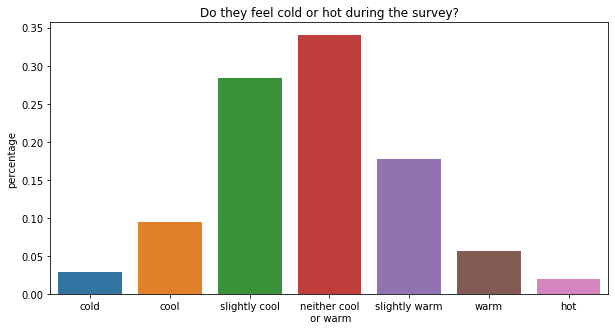

In [75]:
col = 'StateTSVF'
vc = df[col].value_counts(normalize=True)
vc = pd.DataFrame(vc).sort_index()[col]
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title('Do they feel cold or hot during the survey?')
plt.ylabel('percentage')

In [76]:
dics['StateTCVF'] = {1:'comfortable',2:'slight\n uncomforable',3:'uncomfotabe',4:'very\n uncomfortable',5:'extremely\n uncomfortable'}

Text(0, 0.5, 'percentage')

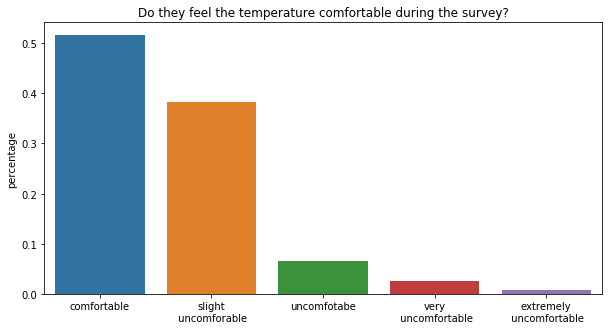

In [77]:
col = 'StateTCVF'
vc = df[col].value_counts(normalize=True)
vc = pd.DataFrame(vc).sort_index()[col]
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title('Do they feel the temperature comfortable during the survey?')
plt.ylabel('percentage')

In [79]:
dics['StateTACF'] = {1:'clearly accptable',2:'just accptable',3:'just unaccptable',4:'clearly unaccptable',}

Text(0, 0.5, 'percentage')

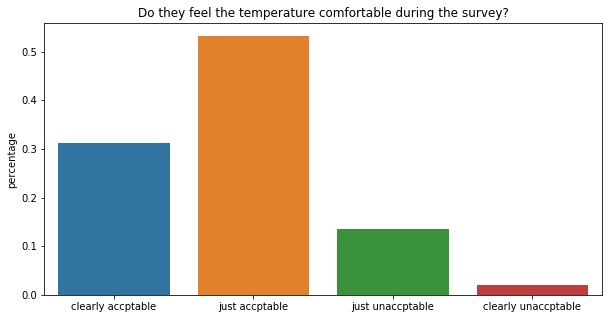

In [80]:
col = 'StateTACF'
vc = df[col].value_counts(normalize=True)
vc = pd.DataFrame(vc).sort_index()[col]
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title('Do they feel the temperature comfortable during the survey?')
plt.ylabel('percentage')

In [93]:
check_description('StateTPVF','Description')

'Thermal preference: 1 much cooler, 2 cooler, 3 slightly cooler; 4 without change; 5 slightly warmer; 6 warmer; 7 much warmer'

In [91]:
dics['StateTPVF'] = {1:'much cooler', 2:'cooler', 3:'slightly cooler',4:'without\nchange',5:'slightly warmer',
                     6:'warmer',7:'much warmer'}

Text(0, 0.5, 'percentage')

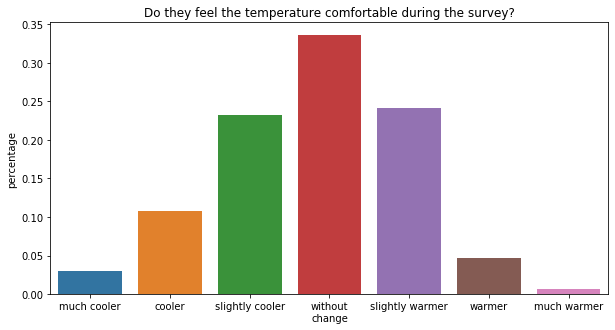

In [92]:
col = 'StateTPVF'
vc = df[col].value_counts(normalize=True)
vc = pd.DataFrame(vc).sort_index()[col]
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc)
plt.title('Do they feel the temperature comfortable during the survey?')
plt.ylabel('percentage')

In [81]:
check_description('SensType')

'If one adjective was used on each side of the thermal sensation scale: 1; in case two adjectives were used: 2 (e.g. hot and warm); in case on warm side one adjective was used, but on cold side two adjectives: 3c; in case on cold side one adjective was used, but on warm side two adjectives: 3h'

In [82]:
dics['SensType'] = {1:'1 adjective used',2:'2 adjectives used','3c':'1 hot adjective used\n2 cold adjective used',
           '3h':'1 cold adjective used\n2 hot adjective used'}

Text(0, 0.5, 'percentage')

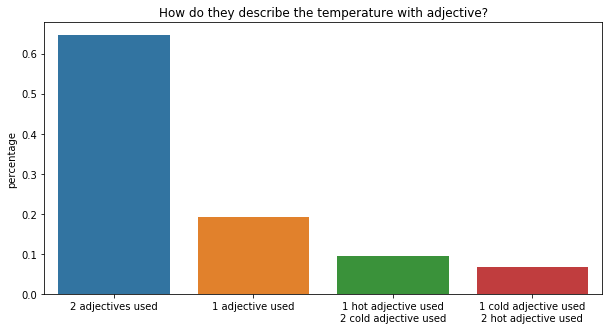

In [83]:
col = 'SensType'
vc = df[col].value_counts(normalize=True)
x = [dics[col][i] for i in vc.index]
plt.figure(figsize=FIGSIZE_S)
sns.barplot(x=x,y=vc.values)
plt.title('How do they describe the temperature with adjective?')
plt.ylabel('percentage')

In [87]:
# Feature engineering

def func_1(x,centre):
    if x < centre:
        return -1
    elif x > centre:
        return 1
    else:
        return 0

df_state = pd.DataFrame(df['StateTSVF'].apply(lambda x: func_1(x,4)),columns=['StateTSVF'])
df_state['StateTCVF'] = df['StateTCVF'].apply(lambda x: func_1(x,0))
df_state['StateTPVF'] = df['StateTPVF'].apply(lambda x: func_1(x,4))
df_state['StateTACF'] = df['StateTACF'].apply(lambda x: func_1(x,2.5))
df_state

,StateTSVF,StateTCVF,StateTPVF,StateTACF
0,-1,-1,-1,-1
1,-1,-1,1,-1
2,-1,1,1,1
3,-1,0,1,1
4,-1,-1,1,-1
...,...,...,...,...
8220,0,-1,0,-1
8221,-1,1,0,-1
8222,0,-1,-1,-1
8223,1,0,-1,-1


# Bivariable analysis

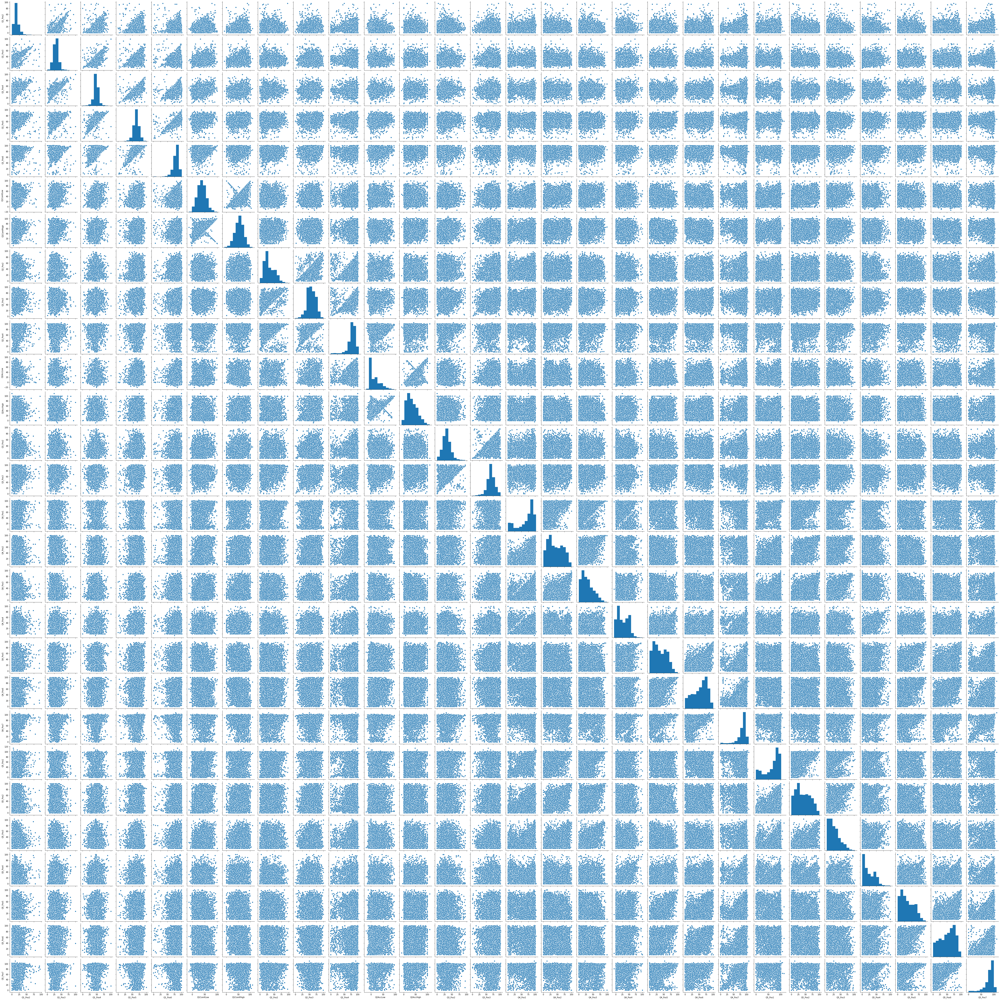

In [150]:
from pandas.plotting import scatter_matrix

col_ls = description[description['type'].isin(['continuous'])]['Variable name'].tolist()[:28]
# scatter_matrix(df[col_ls], alpha=0.2, figsize=(30, 30), diagonal='kde')
sns.pairplot(df[col_ls])

Text(0.5, 1, 'Correlation table')

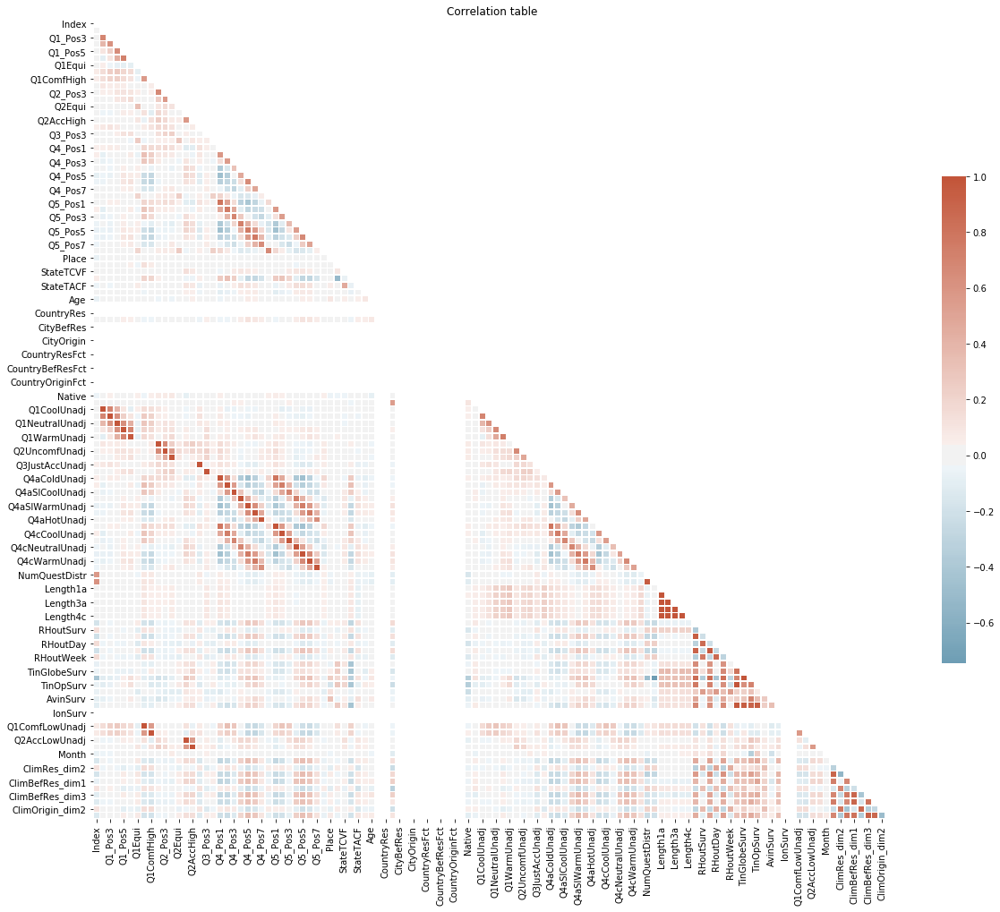

In [84]:
plt.figure(figsize=(20,20))
corr = df.corr()

mask = np.triu(np.ones_like(corr, dtype=bool))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, center=0,square=True, linewidths=.75, cbar_kws={"shrink": .5})
plt.title('Correlation table')

### Statistical testing

We want to know if a factor h has impact to the numerical scales, while we use t-test to test if there is any significant different (p<0.05) between two distribution. For multiple distributions, we use ANOVA to test us if there is **at least two distributions that are significant different**. Hence, after knowing the signficance, we still need to dig deeper into different classes. Like many test, it only valid if every distribution have at least 30 data, so we need to exclude the class that has less than 30 data. 

##### Continuous data

In [97]:
import scipy.stats as stats

# Here we use ANOVA to test if any significant difference between the classs in the column, please note this only 
# indicate there are at least two distirbutions that is statistically different  
def quick_anova_tests(h,cols,df=df,prt=True):
    p_values = []
    significant_cols = []
    for x in cols:
        vc = df[h].value_counts()
        section = df[df[h].isin(vc[vc>30].index)][[h,x]].dropna()
        print('class available in the column: ',section[h].unique()) if prt == True else None
        section = section[[h,x]].dropna()
        print(x,'\t','completeness: ',len(section)/len(df)) if prt == True else None
    #     v1,v2 = stats.ttest_ind(section[section[h]==1][x],section[section[h]==2][x])
        v1,v2 = stats.f_oneway(*[section[section[h]==c][x] for c in section[h].unique()])
        print('\t\t','p-value     : ',v2) if prt == True else None
        p_values.append(v2)
        if v2 < 0.05:
            significant_cols.append(x)
    print('\n') if prt == True else None
    print('summary of the p-values','\n') if prt == True else None
    if prt == True:
        for i in p_values:
            print(i)
    print('\n','scales where significance appear between the classes in: ',h) if prt == True else None
    print(significant_cols) if prt == True else None
    return significant_cols

In [86]:
##### For quick view #####
def plot_distribution_multi(cols,hue=None,df=df,width=2,xlim=False):
    f,axs = plt.subplots(math.ceil(len(cols)/width),width,figsize=(18,5*math.ceil(len(cols)/width)))
    for i,n in enumerate(cols): 
        if hue == None:
            sns.distplot(a=df[n],hist=False,norm_hist=True,ax=axs[i//width,i%width])
        else:
            for h in sorted(df[df[hue].notnull()][hue].unique()):
                sns.distplot(a=df[df[hue]==h][n],hist=False,label=h,norm_hist=True,ax=axs[i//width,i%width])    
        if xlim:
            plt.xlim(xlim)
    plt.show()
    return 

In [94]:
# Example

In [101]:
hue = 'Adapt'
significant_cols = quick_anova_tests(hue,scale_cols,
                                     df=df,
                                     prt=True)


class available in the column:  [3. 2. 1.]
Q1_Pos2 	 completeness:  0.8772036474164133
		 p-value     :  0.12472948885033679
class available in the column:  [3. 2. 1.]
Q1_Pos3 	 completeness:  0.8823100303951368
		 p-value     :  0.736332970751159
class available in the column:  [3. 2. 1.]
Q1_Pos4 	 completeness:  0.8817021276595745
		 p-value     :  0.4452734804263686
class available in the column:  [3. 2. 1.]
Q1_Pos5 	 completeness:  0.8806079027355623
		 p-value     :  0.3037950642991565
class available in the column:  [3. 2. 1.]
Q1_Pos6 	 completeness:  0.8590881458966565
		 p-value     :  0.12074267143142159
class available in the column:  [3. 2. 1.]
Q2_Pos2 	 completeness:  0.8810942249240121
		 p-value     :  0.030391924456146042
class available in the column:  [3. 2. 1.]
Q2_Pos3 	 completeness:  0.88
		 p-value     :  0.09982243547912163
class available in the column:  [3. 2. 1.]
Q2_Pos4 	 completeness:  0.8758662613981762
		 p-value     :  0.1479726345774695
class available in

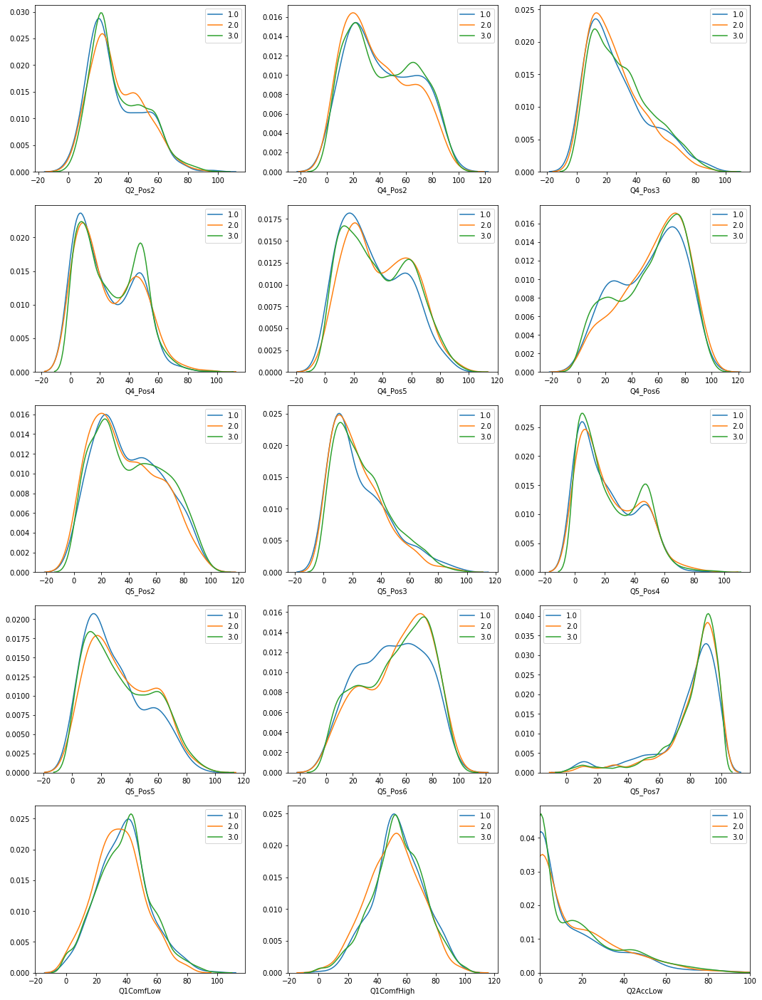

In [102]:
plot_distribution_multi(significant_cols,hue,df=df,width=3,xlim=(0,100))

##### Categorical data

In [577]:
from scipy.stats import chi2_contingency

In [701]:
def quick_chisquare_tests(x,y,data=df,dics=dics,rtn='original'):
    sample = data[[x,y]].dropna()
    if dics != None:
        col1 = sample[x].apply(lambda c: dics[x][c])
        col2 = sample[y].apply(lambda c: dics[y][c])
    else:
        col1 = sample[x]
        col2 = sample[y]
    ctable = pd.crosstab(col1,col2)
#     print(ctable)
    ctable1 = ctable[(ctable > 5).all(axis=1)]
    try:
        p_value = chi2_contingency(ctable1,lambda_="log-likelihood")[1]
        print('index: ',ctable1.index.tolist(),'\n','p_value:',p_value,'\n')
    except:
        print('No sufficient data')
    if rtn == 'original':
        return ctable
    elif rtn == 'normalize':
        return pd.crosstab(col1,col2,normalize='index')
    else: 
        return ctable1

In [702]:
ctable = quick_chisquare_tests('Sex','Adapt',rtn='normalize')
ctable 

index:  ['Female', 'Male'] 
 p_value: 0.15029563792308906 



Adapt,high,low,middle
Sex,,,
Do not specify,0.875000,0.078125,0.046875
Female,0.831823,0.083522,0.084655
Male,0.829673,0.075332,0.094995
Other,0.714286,0.190476,0.095238


In [650]:
ctable = quick_chisquare_tests('PeriodRes','Adapt')
ctable

No sufficient data


Adapt,high,low,middle
PeriodRes,,,
1-3 years,814,0,677
< 1 year,932,600,0
> 3 years,4521,0,0
Do not specify,1,0,0


In [703]:
ctable = quick_chisquare_tests('ClimBefRes_dim1','Adapt',rtn='normalize')
ctable

index:  ['arid', 'quaatorial', 'snow', 'warm'] 
 p_value: 1.1613087968448184e-49 



Adapt,high,low,middle
ClimBefRes_dim1,,,
arid,0.658699,0.158035,0.183267
polar,0.500000,0.142857,0.357143
quaatorial,0.698317,0.125000,0.176683
snow,0.070312,0.445312,0.484375
warm,0.726507,0.136082,0.137411


In [704]:
ctable = quick_chisquare_tests('ClimBefRes_dim2','Adapt',rtn='normalize')
ctable

index:  ['desert', 'fully humid', 'monsoonal', 'steppe', 'summer dry', 'winter dry'] 
 p_value: 2.9237723941645734e-34 



Adapt,high,low,middle
ClimBefRes_dim2,,,
desert,0.520661,0.202479,0.276860
fully humid,0.764301,0.123411,0.112288
monsoonal,0.417808,0.253425,0.328767
steppe,0.718095,0.137143,0.144762
summer dry,0.538647,0.200483,0.260870
winter dry,0.653646,0.149740,0.196615


In [705]:
ctable = quick_chisquare_tests('ClimBefRes_dim3','Adapt',rtn='normalize')
ctable

index:  ['cold arid', 'cool summer', 'hot arid', 'hot summer', 'warm summer'] 
 p_value: 9.7520898494467e-122 



Adapt,high,low,middle
ClimBefRes_dim3,,,
cold arid,0.704800,0.130400,0.164800
cool summer,0.527273,0.200000,0.272727
hot arid,0.585075,0.179104,0.235821
hot summer,0.423404,0.291489,0.285106
polar tundra,0.500000,0.142857,0.357143
warm summer,0.879050,0.056875,0.064075


In [710]:
def migration(x):
    if x>0:
        return 1
    elif x<0:
        return -1
    elif x == 0:
        return 0
    return

df['ClimMigt_dim1'] = (df['ClimRes_dim1'] - df['ClimBefRes_dim1']).apply(migration)
df['ClimMigt_dim2'] = (df['ClimRes_dim2'] - df['ClimBefRes_dim2']).apply(migration)
df['ClimMigt_dim3'] = (df['ClimRes_dim3'] - df['ClimBefRes_dim3']).apply(migration)

In [718]:
dics['ClimMigt_dim1'] = {1:'toward equatorial region',0:'no change',-1:'toward polar region'}
dics['ClimMigt_dim2'] = {1:'toward higher precipitation region',0:'no change',-1:'toward lower precipitation region'}
dics['ClimMigt_dim3'] = {1:'toward hotter region',0:'no change',-1:'toward colder region'}

In [719]:
ctable = quick_chisquare_tests('ClimMigt_dim1','Adapt',rtn='normalize')
ctable*100

index:  ['no change', 'toward equatorial region', 'toward polar region'] 
 p_value: 0.0 



Adapt,high,low,middle
ClimMigt_dim1,,,
no change,82.747804,8.845671,8.406524
toward equatorial region,13.808463,33.853007,52.338530
toward polar region,7.917889,45.454545,46.627566


In [716]:
ctable = quick_chisquare_tests('ClimMigt_dim2','Adapt',rtn='normalize')
ctable*100

index:  ['no change', 'toward higher precipitation region', 'toward lower precipitation region'] 
 p_value: 0.0 



Adapt,high,low,middle
ClimMigt_dim2,,,
no change,89.805825,5.547850,4.646325
toward higher precipitation region,14.701378,42.266462,43.032159
toward lower precipitation region,9.297052,34.693878,56.009070


In [720]:
ctable = quick_chisquare_tests('ClimMigt_dim3','Adapt',rtn='normalize')
ctable*100

index:  ['no change', 'toward colder region', 'toward hotter region'] 
 p_value: 0.0 



Adapt,high,low,middle
ClimMigt_dim3,,,
no change,88.862479,4.889643,6.247878
toward colder region,7.809847,49.405772,42.784380
toward hotter region,14.414414,34.684685,50.900901


# Modelling (ongoing)

In [150]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier,DecisionTreeRegressor
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.svm import SVC,SVR
from sklearn.metrics import r2_score,accuracy_score,f1_score,confusion_matrix

Here we want to know whether we can model a relationship between participant sensation during the survey, and how they draw on the scale

In [239]:
check_description('StateTSVF',item='Description')

'Thermal sensation: 1 cold; 2 cool; 3 slightly cool; 4 neutral; 5 slightly warm; 6 warm; 7 hot'

In [233]:
# data = pd.concat([df_scale,df['StateTSVF']],axis=1).dropna()
data = df[[f'Q1_Pos{i}' for i in range(2,7)]+[f'Q4_Pos{i}' for i in range(1,8)]+['StateTSVF']].dropna()
data.shape
data.head(5)

,Q1_Pos2,Q1_Pos3,Q1_Pos4,Q1_Pos5,Q1_Pos6,Q4_Pos1,Q4_Pos2,Q4_Pos3,Q4_Pos4,Q4_Pos5,Q4_Pos6,Q4_Pos7,StateTSVF
0,10.0,19.0,46.0,69.0,90.0,70.0,22.0,10.0,34.0,80.0,88.0,96.0,3.0
1,8.0,20.0,70.0,85.0,94.0,98.0,95.0,32.0,8.0,42.0,53.0,86.0,3.0
3,16.0,25.0,60.0,71.0,80.0,76.0,68.0,60.0,45.0,35.0,29.0,20.0,1.0
4,24.0,44.0,54.0,63.0,80.0,89.0,52.0,10.0,5.0,18.0,48.0,72.0,2.0
6,15.0,19.0,44.0,70.0,74.0,81.0,71.0,48.0,8.0,18.0,27.0,89.0,3.0


In [240]:
# binarize = lambda x: 1 if x > 1 else 0 

def three(x,c):
    if x>c:
        return 1
    elif x<c:
        return -1
    elif x == c:
        return 0
    return
    

X = data.drop('StateTSVF',axis=1)/100
y = data['StateTSVF'].apply(lambda x: three(x,4)) #.astype(float)

In [241]:
from sklearn.model_selection import KFold,train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=666)

In [242]:
from sklearn.decomposition import PCA

# dimension reduction with PCA
pca = PCA()
pca.fit(X_train)
# X_train = pca.transform(X_train)
# X_test = pca.transform(X_test)
explained_variance = pca.explained_variance_ratio_
explained_variance

array([0.40185025, 0.16684656, 0.15850193, 0.06600808, 0.05348542,
       0.04935172, 0.03148855, 0.03105121, 0.0254176 , 0.00686031,
       0.0058477 , 0.00329067])

In [216]:
from sklearn.preprocessing import StandardScaler,MinMaxScaler

# Scaler
scaler = StandardScaler()
y_train = scaler.fit_transform(y_train.to_numpy().reshape(-1,1))
y_test = scaler.transform(y_test.to_numpy().reshape(-1,1))

In [243]:
# Machine Learning model

### classifier 
models = {
    "Regression": LogisticRegression(),
    "DecisionTree": DecisionTreeClassifier(),
    "RandomForest": RandomForestClassifier(),
    "Support Vector": SVC(),
}

### regressor
# models = {
#     "Regression": LinearRegression(),
#     "DecisionTree": DecisionTreeRegressor(),
#     "Support Vector": SVR(),
# }


for key, mdl in models.items():
    mdl.fit(X_train, y_train)
    y_pred = mdl.predict(X=X_test)
    training_score = cross_val_score(mdl, X_train, y_train, cv=5)
    print(mdl.__class__.__name__, ": ", round(training_score.mean(), 2))

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-reg

LogisticRegression :  0.42
DecisionTreeClassifier :  0.35
RandomForestClassifier :  0.4
SVC :  0.42


In [250]:
# xg boosting

xgb_params = {'max_depth': 5, 
              'n_estimators': 512, 
              'learning_rate': 0.01, 
              'gamma': 0.66, 
              }
xgb_params['random_state'] = 0
xgb = XGBClassifier(**xgb_params)
xgb.fit(X_train, y_train)
y_pred = xgb.predict(X_test)
print('Optimized XGBClassifier accuracy: ', accuracy_score(y_test, y_pred))
# print('Optimized XGBClassifier f1-score', f1_score(y_test, preds))


Optimized XGBClassifier accuracy:  0.411976911976912


Text(33.0, 0.5, 'True labels')

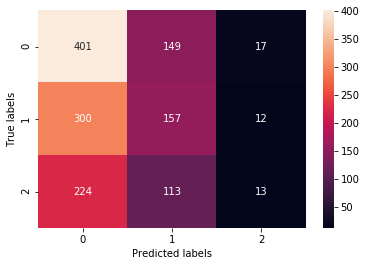

In [251]:
cm = confusion_matrix(y_test, y_pred)

ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax, fmt='g')

ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')

In [314]:
dics = {'Sex':{1:'Female',2:'Male',3:'Other',4:'Do not specify'},
'Age':{1:'< 21', 2:'21-25',3:'26-30',4:'31-35',5:'36-40',6:'> 40',7:'Do not wish to specify'},
'PeriodRes':{1:'< 1 year',2:'1-3 years',3:'> 3 years',4:'Do not specify'},
'Native':{1:'Yes',0:'No'},
'Adapt':{ 1:'low',2:'middle',3:'high'},
'Season':{'Summer':'Summer', 'Fall':'Autumn', 'summer':'Summer', 'Winter ':'Winter', 'winter':'Winter', 'Autumn ':'Autumn',
'Winter':'Winter', 'Spring':'Spring', 'spring':'Spring', 'autumn':'Autumn', 'Autumn':'Autumn', 'Wet':'Wet', 'Wet ':'Wet',
'Dry':'Dry', 'Automn':'Autumn','wet':'Wet', 'Monsoon':'Summer', 'summer dry':'Summer',
'winter dry':'Winter', 'summer not dry or wet':'Summer',
'Second Inter-Monsoon Season':'Autumn', 'Southwest-monsoon Season':'Summer',
'Hot':'Summer','Wet Season':'Wet', 'dry':'Dry', 'DRY':'Dry', 'fall':'Autumn'},
'Month':{1:'Jan',2:"Feb",3:"Mar",4:"Apr",5:"May",6:"Jun",7:"Jul",8:"Aug",9:"Sept",10:"Oct",11:"Nov",12:"Dec"}
       }

In [ ]:
# plt.figure(figsize=(8,5))
# f,ax = plt.subplots()
# plt.xlim(-0.025,1.025)
# q1 = [f'Q4_Pos{i}' for i in range(1,8) ]
# plt.title('Position of thermal perception on scale')
# plt.axvline(x=0,c='b')
# plt.axvline(x=1,c='r')
# for col in q1:
#     sns.distplot(a=df_scale[col],kde=True,hist=False,label='',ax=ax)
    
# # ax2 = ax.twinx()
# # for col in ['Q2AccLow','Q2AccHigh']:
# #     sns.distplot(a=df_scale[col],kde=False,hist=True,ax=ax2,label='')
# # ax2.legend(['low','high'],
# #            bbox_to_anchor=(1.1, 0.15), loc=2, borderaxespad=0.)

# legend_ = [
#     'comfortable',
#     'extremely uncomfortable',
# ] + ['cold','cool','slightly cool','neither cool or warm','slightly warm','warm','hot']
# ax.legend(legend_,
#            bbox_to_anchor=(1.1, 1), loc=2, borderaxespad=0.)
# plt.xlabel('position (scaled)')
# plt.show()

In [ ]:
# Q1Equi